In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [24]:
filename = 'Merged_csv.csv'

In [21]:
df = pd.read_csv(filename, delimiter=";")

In [25]:
df.head()

,OBJECTID,ULAND,UREGBEZ,UKREIS,UGEMEINDE,UJAHR,UMONAT,USTUNDE,UWOCHENTAG,UKATEGORIE,...,IstPKW,IstFuss,IstKrad,IstGkfz,IstSonstig,LINREFX,LINREFY,XGCSWGS84,YGCSWGS84,OBJECTID_1
0,6189.0,2,6,2,603,2016,4,15,2,3,...,1,0,0,0.0,0,582353.3944,5.926138e+06,10.240903,53.477780,NaN
1,6573.0,2,4,2,405,2016,2,15,4,3,...,1,0,0,0.0,0,565114.3660,5.939258e+06,9.983923,53.598104,NaN
2,6590.0,2,4,8,418,2016,3,14,6,3,...,0,1,0,0.0,0,567467.7475,5.937258e+06,10.019045,53.579830,NaN
3,6607.0,2,3,6,318,2016,3,13,7,3,...,1,0,0,0.0,0,562842.4179,5.941421e+06,9.950034,53.617822,NaN
4,6696.0,2,2,9,221,2016,1,8,6,3,...,1,0,0,0.0,0,555294.0173,5.936479e+06,9.835057,53.574259,NaN


In [26]:
list(df.columns)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9019 entries, 0 to 9018
Data columns (total 25 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   OBJECTID    6696 non-null   float64
 1   ULAND       9019 non-null   int64  
 2   UREGBEZ     9019 non-null   int64  
 3   UKREIS      9019 non-null   int64  
 4   UGEMEINDE   9019 non-null   int64  
 5   UJAHR       9019 non-null   int64  
 6   UMONAT      9019 non-null   int64  
 7   USTUNDE     9019 non-null   int64  
 8   UWOCHENTAG  9019 non-null   int64  
 9   UKATEGORIE  9019 non-null   int64  
 10  UART        9019 non-null   int64  
 11  UTYP1       9019 non-null   int64  
 12  ULICHTVERH  9019 non-null   int64  
 13  STRZUSTAND  9019 non-null   int64  
 14  IstRad      9019 non-null   int64  
 15  IstPKW      9019 non-null   int64  
 16  IstFuss     9019 non-null   int64  
 17  IstKrad     9019 non-null   int64  
 18  IstGkfz     6839 non-null   float64
 19  IstSonstig  9019 non-null  

In [46]:
# Change columns names. Replace spaces by underscores and upper case letters by lower case letters.
df.rename(columns=lambda x:x.replace(' ','_').lower(), inplace=True)

#Rename
df = df.rename(columns={'ujahr': 'year', 'umonat': 'month', 'uwochentag': 'day', 'ustunde': 'hour', 'ygcswgs84': 'latitude', 'xgcswgs84': 'longitude'})

# first rows after changing names
df.head()


,objectid,uland,uregbez,ukreis,ugemeinde,year,month,hour,day,ukategorie,...,istfuss,istkrad,istgkfz,istsonstig,linrefx,linrefy,longitude,latitude,objectid_1,date
0,6189.0,2,6,2,603,2016,4,15,2,3,...,0,0,0.0,0,582353.3944,5.926138e+06,10.240903,53.477780,NaN,2016-04-02 15:00:00
1,6573.0,2,4,2,405,2016,2,15,4,3,...,0,0,0.0,0,565114.3660,5.939258e+06,9.983923,53.598104,NaN,2016-02-04 15:00:00
2,6590.0,2,4,8,418,2016,3,14,6,3,...,1,0,0.0,0,567467.7475,5.937258e+06,10.019045,53.579830,NaN,2016-03-06 14:00:00
3,6607.0,2,3,6,318,2016,3,13,7,3,...,0,0,0.0,0,562842.4179,5.941421e+06,9.950034,53.617822,NaN,2016-03-07 13:00:00
4,6696.0,2,2,9,221,2016,1,8,6,3,...,0,0,0.0,0,555294.0173,5.936479e+06,9.835057,53.574259,NaN,2016-01-06 08:00:00


In [28]:
df.columns

Index(['objectid', 'uland', 'uregbez', 'ukreis', 'ugemeinde', 'year', 'month',
       'hour', 'day', 'ukategorie', 'uart', 'utyp1', 'ulichtverh',
       'strzustand', 'istrad', 'istpkw', 'istfuss', 'istkrad', 'istgkfz',
       'istsonstig', 'linrefx', 'linrefy', 'xgcswgs84', 'ygcswgs84',
       'objectid_1'],
      dtype='object')

In [29]:
# Combine columns month day hour and year to create a single datetime column.
df['date']=pd.to_datetime(df[['year', 'month', 'day','hour']])

# Observe the first 5 columns.
df.head()

,objectid,uland,uregbez,ukreis,ugemeinde,year,month,hour,day,ukategorie,...,istfuss,istkrad,istgkfz,istsonstig,linrefx,linrefy,xgcswgs84,ygcswgs84,objectid_1,date
0,6189.0,2,6,2,603,2016,4,15,2,3,...,0,0,0.0,0,582353.3944,5.926138e+06,10.240903,53.477780,NaN,2016-04-02 15:00:00
1,6573.0,2,4,2,405,2016,2,15,4,3,...,0,0,0.0,0,565114.3660,5.939258e+06,9.983923,53.598104,NaN,2016-02-04 15:00:00
2,6590.0,2,4,8,418,2016,3,14,6,3,...,1,0,0.0,0,567467.7475,5.937258e+06,10.019045,53.579830,NaN,2016-03-06 14:00:00
3,6607.0,2,3,6,318,2016,3,13,7,3,...,0,0,0.0,0,562842.4179,5.941421e+06,9.950034,53.617822,NaN,2016-03-07 13:00:00
4,6696.0,2,2,9,221,2016,1,8,6,3,...,0,0,0.0,0,555294.0173,5.936479e+06,9.835057,53.574259,NaN,2016-01-06 08:00:00


In [30]:
# Check the datatype of the date column
df.date.dtypes
# dtype('<M8[ns]')

dtype('<M8[ns]')

In [35]:
import calendar
# Number of accident per month
accidents_month = df.groupby(df['date'].dt.month).count().istrad

# Replace the month integers by month names.
accidents_month.index=[calendar.month_name[x] for x in range(1,13)]

accidents_month

January       405
February      402
March         458
April         772
May           942
June         1208
July          946
August        956
September    1022
October       746
November      673
December      489
Name: istrad, dtype: int64

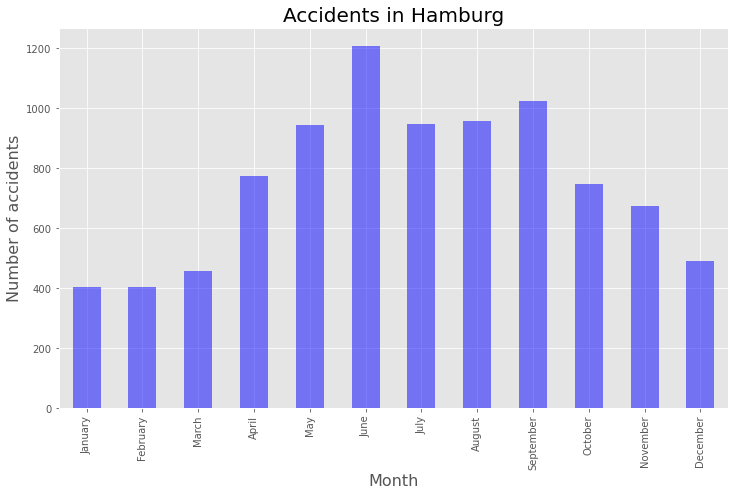

In [36]:
import matplotlib.pyplot as plt

plt.style.use('ggplot')

# plot accidents per month
accidents_month.plot(kind='bar',figsize=(12,7), color='blue', alpha=0.5)

# title and x,y labels
plt.title('Accidents in Hamburg', fontsize=20)
plt.xlabel('Month',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

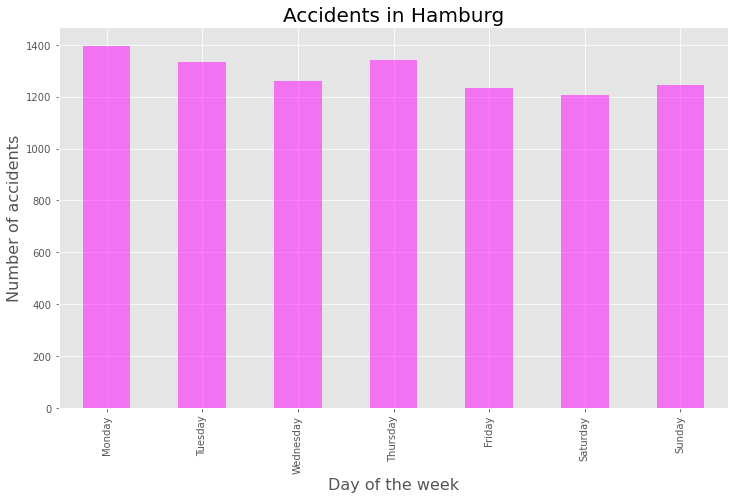

In [38]:
# Number of accident per day of the week
accidents_day = df.groupby(df['date'].dt.dayofweek).count().date

# Replace the day integers by day names.
accidents_day.index=[calendar.day_name[x] for x in range(0,7)]

# plot accidents per day
accidents_day.plot(kind='bar',figsize=(12,7), color='magenta', alpha=0.5)

# title and x,y labels
plt.title('Accidents in Hamburg', fontsize=20)
plt.xlabel('Day of the week',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);


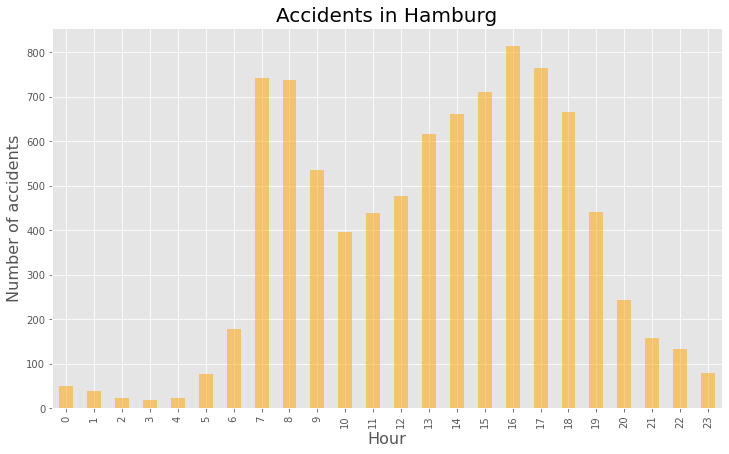

In [40]:
# Number of accident per hour
accidents_hour = df.groupby(df['date'].dt.hour).count().date

# plot accidents per hour
accidents_hour.plot(kind='bar',figsize=(12,7), color='orange', alpha=0.5)

# title and x,y labels
plt.title('Accidents in Hamburg', fontsize=20)
plt.xlabel('Hour',fontsize=16)
plt.ylabel('Number of accidents',fontsize=16);

In [45]:
#!pip install folium
import folium

# Define a map centered around Barcelona
hamburg_map = folium.Map(location=[53.56233529434252, 9.99949411892394], zoom_start=12)

# Display the map
hamburg_map

In [54]:
# Display only accidents where serious injuries where recorded
for lat, lng, label in zip(df.latitude, df.longitude, df.ukategorie.astype(str)):
    if label!='0':
        folium.features.CircleMarker(
            [lat, lng],
            radius=3,
            color='red',
            fill=True,
            popup=label,
            fill_color='darkred',
            fill_opacity=0.6
        ).add_to(hamburg_map)
    
# Show map
hamburg_map

In [56]:
from folium import plugins
# Define a map centered around HH

hamburg_map = folium.Map(location=[53.56233529434252, 9.99949411892394], zoom_start=12)

# Instantiate a mark cluster object for the car accidents
accidents = plugins.MarkerCluster().add_to(hamburg_map)

# Display only accidents where serious injuries where recorded
for lat, lng, label in zip(df.latitude, df.longitude, df.year.astype(str)):
    if label!='0':
        folium.Marker(
            location=[lat, lng],
            icon=None,
            popup=label,
        ).add_to(accidents)

# Display map
hamburg_map

In [51]:
from folium.plugins import HeatMapWithTime

# Define a map centered around HH
hamburg_map = folium.Map(location=[53.56233529434252, 9.99949411892394], zoom_start=12)

# Nested list that contains the latitud and the longitud of the different accidents. 
hour_list = [[] for _ in range(24)]
for lat,log,hour in zip(df.latitude,df.longitude,df.date.dt.hour):
    hour_list[hour].append([lat,log]) 

# Labels indicating the hours
index = [str(i)+' Hours' for i in range(24)]

# Instantiate a heat map wiht time object for the car accidents
HeatMapWithTime(hour_list, index).add_to(hamburg_map)

hamburg_map